# PROJECT: INTRUSION DETECTION SYSTEM

## 1- Data Preporcessing

### 1-1 Analyze the dataset to understand the distribution of classes.

In [67]:
import pandas as pd
from ydata_profiling import ProfileReport

# Charger vos datasets
df = pd.read_csv('Dataset_project_RS_random.csv')
'''
df2 = pd.read_csv('Dataset_project_RS.csv')

# Générer le rapport de profilage
profile = ProfileReport(df, title="Device Dataset Profiling Report", explorative=True, correlations={"auto": {"calculate": False}})

# Afficher le rapport directement dans le notebook
profile.to_notebook_iframe()'''


'\ndf2 = pd.read_csv(\'Dataset_project_RS.csv\')\n\n# Générer le rapport de profilage\nprofile = ProfileReport(df, title="Device Dataset Profiling Report", explorative=True, correlations={"auto": {"calculate": False}})\n\n# Afficher le rapport directement dans le notebook\nprofile.to_notebook_iframe()'

## Rapport de Profilage du Dataset "Device Dataset"

Le rapport de profilage du dataset "Device Dataset" met en évidence plusieurs points clés concernant la qualité et la structure des données :

### 1. Présence de Valeurs Constantes

- **Variables constantes** : Les colonnes `urgent` et `num_outbound_cmds` ont une valeur constante de "0" sur l'ensemble du dataset. Ces variables n'apportent aucune information discriminante pour les analyses ou les modèles prédictifs.

### 2. Variables Hautement Déséquilibrées

- **Colonnes déséquilibrées** : Plusieurs variables catégorielles présentent une forte imbalance, où une seule catégorie représente plus de 90 % des observations :
  - `land` (99,6 % d'une seule valeur)
  - `wrong_fragment` (94,7 %)
  - `num_failed_logins` (98,9 %)
  - `root_shell` (98,4 %)
  - `su_attempted` (99,4 %)
  - `num_shells` (99,7 %)
  - `is_guest_login` (92,5 %)
  - `outcome` (56,4 % dans une seule classe)

### 3. Variables Fortement Asymétriques (Skewed)

- **Asymétrie élevée** : Certaines variables numériques ont une distribution très asymétrique, avec un skewness élevé :
  - `src_bytes` (γ₁ = 27,24)
  - `dst_bytes` (γ₁ = 137,74)
  - `num_compromised` (γ₁ = 59,33)
  - `num_root` (γ₁ = 59,95)
  - `num_file_creations` (γ₁ = 48,07)
  - `num_access_files` (γ₁ = 48,72)

### 4. Variables avec un Haut Pourcentage de Zéros

- **Proportion de zéros** : De nombreuses variables contiennent une proportion significative de valeurs nulles (zéros), ce qui peut affecter les analyses statistiques et les performances des modèles :
  - `duration` (92,1 % de zéros)
  - `hot` (97,9 %)
  - `num_compromised` (98,9 %)
  - `num_root` (99,4 %)
  - `num_file_creations` (99,7 %)
  - `num_access_files` (99,8 %)
  - D'autres variables ont plus de 60 % de zéros, comme `serror_rate`, `rerror_rate`, `srv_rerror_rate`, etc.

### 5. Présence de Doublons

- **Lignes dupliquées** : Le dataset contient 1 856 lignes dupliquées, ce qui représente 9,8 % du total des données. Cela peut biaiser les analyses et doit être traité en supprimant les doublons.

### 6. Variables avec Valeurs Extrêmes

- **Valeurs maximales élevées** : Les variables `src_bytes` et `dst_bytes` ont des valeurs maximales très élevées (jusqu'à plus d'un milliard pour `dst_bytes`), ce qui contribue à leur asymétrie et peut nécessiter une transformation pour stabiliser la variance.

### 7. Distribution de la Variable Cible (`outcome`)

- **Imbalance dans les classes** : La variable cible est déséquilibrée, avec 56,4 % des observations appartenant à une seule classe (`normal`), ce qui peut affecter la performance des modèles de classification.

### 8. Types de Variables

- **Diversité des types** : Le dataset comprend des variables numériques (réelles), catégorielles et textuelles, nécessitant des traitements adaptés pour chaque type lors de l'analyse et de la modélisation.


_On commence par supprimer les colonnes constantes car elles n'apportent aucune information._

In [68]:
# Suppression des colonnes constantes
df.drop(columns="urgent")
df.drop(columns="num_outbound_cmds")

# Obtenir le nombre de lignes et de colonnes
n_rows, n_cols = df.shape

print(f"Nombre de lignes : {n_rows}")
print(f"Nombre de colonnes : {n_cols}")

Nombre de lignes : 18975
Nombre de colonnes : 36


In [69]:
# Identifier les colonnes avec plus de 80% de zéros
zero_threshold = 0.80
zero_columns = [col for col in df.columns if (df[col] == 0).mean() > zero_threshold]
df.drop(columns=zero_columns, inplace=True)
print(zero_columns)

['duration', 'land', 'wrong_fragment', 'urgent', 'hot', 'num_failed_logins', 'num_compromised', 'root_shell', 'su_attempted', 'num_root', 'num_file_creations', 'num_shells', 'num_access_files', 'num_outbound_cmds', 'is_guest_login', 'rerror_rate', 'srv_rerror_rate', 'dst_host_rerror_rate', 'dst_host_srv_rerror_rate']


### 1-2 Encode categorical features appropriately

Parmis les colonnes qui restent on détecte les colonnes catégorielles ensuite on les encodes en utilisant OneHotEncoder d'abord sur toutes les colonnes catégorielles qui ne sont pas la variable cible.

In [78]:
n_rows, n_cols = df.shape

print(f"Nombre de lignes : {n_rows}")
print(f"Nombre de colonnes : {n_cols}")
print(df.columns)

Nombre de lignes : 18975
Nombre de colonnes : 17
Index(['protocol_type', 'service', 'src_bytes', 'dst_bytes', 'logged_in',
       'serror_rate', 'same_srv_rate', 'diff_srv_rate', 'srv_diff_host_rate',
       'dst_host_count', 'dst_host_same_srv_rate', 'dst_host_diff_srv_rate',
       'dst_host_srv_diff_host_rate', 'dst_host_serror_rate',
       'dst_host_srv_serror_rate', 'level', 'outcome'],
      dtype='object')


In [4]:
import seaborn as sns
from sklearn.preprocessing import OneHotEncoder

# Sélectionner les colonnes de type object (qui sont souvent des colonnes catégorielles)
categorical_columns = df.select_dtypes(include=['object']).columns

print(f"Colonnes catégorielles : {categorical_columns}")


# Colonnes catégorielles à encoder
categorical_columns = ['protocol_type', 'service']

# Encodage avec OneHotEncoder
one_hot_encoder = OneHotEncoder(sparse=False, drop='first')  # drop='first' pour éviter les multicolinéarités
encoded_columns = one_hot_encoder.fit_transform(df[categorical_columns])

# Transformer en dataframe et ajouter au dataframe original
encoded_df = pd.DataFrame(encoded_columns, columns=one_hot_encoder.get_feature_names_out(categorical_columns))
df = pd.concat([df.drop(columns=categorical_columns), encoded_df], axis=1)

Colonnes catégorielles : Index(['protocol_type', 'service', 'outcome'], dtype='object')


### 1-3 Handle missing values

Après avoir encoder on se rends compte après une autre analyse on se rends compte qu'il y a des données manquantes. On utilise donc Simple Imputer pour ajouter les données manquantes.

On supprime aussi les lignes qui sont dupliquées.

In [5]:

# Pour les variables numériques : Remplacement des valeurs manquantes par la médiane
from sklearn.impute import SimpleImputer
import numpy as np

numeric_columns = df.select_dtypes(include=[np.number]).columns
imputer_num = SimpleImputer(strategy='median')

# Appliquer l'imputation aux colonnes numériques
df[numeric_columns] = imputer_num.fit_transform(df[numeric_columns])

print("Imputation des valeurs manquantes (numériques) terminée.")

# Suppression des lignes dupliquées
df.drop_duplicates(inplace=True)


Imputation des valeurs manquantes (numériques) terminée.


## 2 Feature Selection

Ce code effectue la sélection des features et la préparation des données pour un modèle prédictif de machine learning en utilisant les étapes suivantes :

#### 2-1 Séparation des Features et de la Variable Cible

- La variable cible (colonne 'outcome') est extraite du DataFrame df, et les features restantes sont stockées dans X.
- La variable cible est stockée dans y, pour être utilisée plus tard dans le processus de modélisation.

#### 2-2 Sélection des Features via le Filtre de Variance (Feature Selection)

- Le filtre de variance est appliqué aux features (X) à l'aide de VarianceThreshold.
- Ce filtre supprime les features dont la variance est inférieure à un seuil spécifié (ici 0.1). Les variables avec une faible variance n'apportent souvent pas suffisamment d'information pour le modèle, notamment celles qui sont constantes ou presque constantes.
Cela réduit la dimensionnalité des données en supprimant les features non pertinentes.

**On utilise aussi getdummies pour la variable cible.**

In [6]:
import pandas as pd
from sklearn.feature_selection import VarianceThreshold
from sklearn.model_selection import train_test_split

# Séparer les features et la variable cible
target_column = 'outcome' 
X = df.drop(columns=[target_column])  # Supprimer la colonne cible des features
y = df[target_column]  # Stocker la variable cible dans 'y'

# Appliquer le filtre de variance sur les features
selector = VarianceThreshold(threshold=0.1)  # Par exemple, seuil de 0.1
X_reduced = selector.fit_transform(X)  # Réduire les features basées sur la variance

# Vérification
print(f"Taille des features avant réduction : {X.shape}")
print(f"Taille des features après réduction : {X_reduced.shape}")

# Diviser les données en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X_reduced, y, test_size=0.3, random_state=42)

# Combiner y_train et y_test pour encodage
y_combined = pd.concat([y_train, y_test])

# Encodage de la variable cible avec pd.get_dummies()
y_encoded = pd.get_dummies(y_combined, drop_first=True)

# Séparer à nouveau y_encoded en y_train et y_test
y_train_encoded = y_encoded[:len(y_train)]
y_test_encoded = y_encoded[len(y_train):]

# Vérification
print(f"Taille de X_train : {X_train.shape}")
print(f"Taille de X_test : {X_test.shape}")
print(f"Taille de y_train_encoded : {y_train_encoded.shape}")
print(f"Taille de y_test_encoded : {y_test_encoded.shape}")


Taille des features avant réduction : (15829, 80)
Taille des features après réduction : (15829, 14)
Taille de X_train : (11080, 14)
Taille de X_test : (4749, 14)
Taille de y_train_encoded : (11080, 17)
Taille de y_test_encoded : (4749, 17)


Le code utilise StandardScaler pour normaliser les données d'entraînement et de test en ajustant chaque feature afin qu'elle ait une moyenne de 0 et un écart-type de 1, ce qui est essentiel pour les modèles sensibles à l'échelle des variables comme le KNN, SVM, ou les réseaux de neurones. Le scaler est d'abord ajusté sur les données d'entraînement avec fit_transform(), puis appliqué aux données de test via transform() pour garantir une normalisation cohérente entre les ensembles. Enfin, une visualisation des données normalisées est tentée avec un heatmap, mais seule celle de X_test_scaled est affichée.

Axes(0.125,0.11;0.62x0.77)


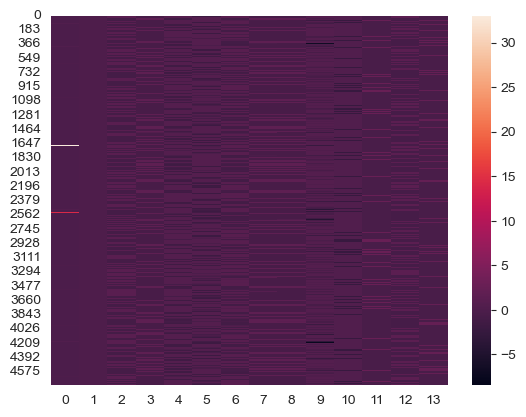

In [7]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
#print(sns.heatmap(X_train_scaled))
print(sns.heatmap(X_test_scaled))

## 3- Model Selection

### 3-1 K-Nearest Neighbors (KNN)

- **Justification théorique** : KNN est un algorithme basé sur la distance qui classe un échantillon en fonction des labels de ses plus proches voisins. Il est efficace pour les problèmes simples et linéaires.

- **Caractéristiques du dataset** : Comme KNN repose sur les distances entre les points, il peut être influencé par des variables asymétriques ou des outliers. Étant donné que le dataset contient des distributions asymétriques et un grand nombre de zéros, une normalisation des données est essentielle. KNN fonctionne bien sur des datasets de taille modérée(18 975 lignes).

In [8]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt

# Définir le modèle KNN avec des hyperparamètres manuels
knn_model = KNeighborsClassifier(n_neighbors=5, weights='uniform', metric='minkowski')

# Entraînement du modèle
knn_model.fit(X_train_scaled, y_train)

# Prédictions sur le jeu de test
y_pred_knn = knn_model.predict(X_test_scaled)

# Évaluation
print("=== K-Nearest Neighbors ===")
print(f"Accuracy: {accuracy_score(y_test, y_pred_knn):.4f}")
print(f"Precision (weighted): {precision_score(y_test, y_pred_knn, average='weighted', zero_division=1):.4f}")
print(f"Recall (weighted): {recall_score(y_test, y_pred_knn, average='weighted', zero_division=1):.4f}")
print(f"F1 Score (weighted): {f1_score(y_test, y_pred_knn, average='weighted', zero_division=1):.4f}")
print("\nClassification Report:\n", classification_report(y_test, y_pred_knn, zero_division=1))


=== K-Nearest Neighbors ===
Accuracy: 0.9800
Precision (weighted): 0.9815
Recall (weighted): 0.9800
F1 Score (weighted): 0.9797

Classification Report:
                  precision    recall  f1-score   support

           back       1.00      1.00      1.00        39
buffer_overflow       1.00      0.67      0.80         3
   guess_passwd       0.50      1.00      0.67         1
        ipsweep       0.62      0.85      0.72        34
           land       1.00      0.00      0.00         3
        neptune       0.99      1.00      0.99      1527
           nmap       0.87      0.65      0.74        40
         normal       1.00      0.99      0.99      2736
            pod       0.71      0.42      0.53        12
      portsweep       0.82      0.84      0.83        80
        rootkit       1.00      0.00      0.00         1
          satan       0.93      0.89      0.91       125
          smurf       0.92      0.98      0.95        84
       teardrop       0.88      1.00      0.94  

### 3-2 Multi-Layer Perceptron (MLP) - Réseaux de Neurones

- **Justification théorique** : Les réseaux de neurones sont puissants pour capturer des patterns complexes dans les données, particulièrement pour les datasets avec des relations non linéaires entre les variables. Ils peuvent aussi bien fonctionner sur des datasets de taille modérée à grande.


- **Caractéristiques du dataset** : Avec un mélange de variables numériques et catégorielles, un réseau de neurones pourrait s'avérer utile pour capturer des interactions complexes dans le dataset, particulièrement après normalisation.



In [9]:
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt

# Définir le modèle MLP avec des hyperparamètres manuels
mlp_model = MLPClassifier(hidden_layer_sizes=(100,), activation='relu', solver='adam', alpha=0.0001, learning_rate='constant', max_iter=600, random_state=42)

# Entraînement du modèle
mlp_model.fit(X_train_scaled, y_train)

# Prédictions sur le jeu de test
y_pred_mlp = mlp_model.predict(X_test_scaled)

# Évaluation
print("=== Multi-Layer Perceptron ===")
print(f"Accuracy: {accuracy_score(y_test, y_pred_mlp):.4f}")
print(f"Precision (weighted): {precision_score(y_test, y_pred_mlp, average='weighted', zero_division=1):.4f}")
print(f"Recall (weighted): {recall_score(y_test, y_pred_mlp, average='weighted', zero_division=1):.4f}")
print(f"F1 Score (weighted): {f1_score(y_test, y_pred_mlp, average='weighted', zero_division=1):.4f}")
print("\nClassification Report:\n", classification_report(y_test, y_pred_mlp, zero_division=1))


=== Multi-Layer Perceptron ===
Accuracy: 0.9817
Precision (weighted): 0.9840
Recall (weighted): 0.9817
F1 Score (weighted): 0.9819

Classification Report:
                  precision    recall  f1-score   support

           back       1.00      1.00      1.00        39
buffer_overflow       1.00      0.33      0.50         3
   guess_passwd       0.50      1.00      0.67         1
        ipsweep       0.54      0.88      0.67        34
           land       1.00      1.00      1.00         3
     loadmodule       0.00      1.00      0.00         0
        neptune       0.99      0.99      0.99      1527
           nmap       0.81      0.53      0.64        40
         normal       1.00      0.99      0.99      2736
            pod       0.62      0.42      0.50        12
      portsweep       0.87      0.90      0.88        80
        rootkit       1.00      0.00      0.00         1
          satan       0.95      0.96      0.96       125
          smurf       0.96      0.95      0.9

### 3-3 Decision Tree (Arbre de décision) :

- **Justification théorique** : Les arbres de décision sont adaptés aux datasets mixtes (numériques et catégoriels) et sont capables de gérer des variables catégorielles sans transformation complexe (comme l'encodage). Ils ne sont pas affectés par la normalisation ou l’échelle des variables.

- **Caractéristiques du dataset** : Comme le dataset contient des variables asymétriques et catégorielles, un arbre de décision peut capturer les interactions non linéaires entre les variables sans nécessiter de prétraitement complexe.

In [10]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
import matplotlib.pyplot as plt
import seaborn as sns

# Définir le modèle Decision Tree avec des hyperparamètres manuels
dt_model = DecisionTreeClassifier(criterion='gini', splitter='best', max_depth=20, min_samples_split=2, min_samples_leaf=1, max_features=None, random_state=42)

# Entraînement du modèle
dt_model.fit(X_train_scaled, y_train)

# Prédictions sur le jeu de test
y_pred_dt = dt_model.predict(X_test_scaled)

# Évaluation
print("=== Decision Tree ===")
print(f"Accuracy: {accuracy_score(y_test, y_pred_dt):.4f}")
print(f"Precision (weighted): {precision_score(y_test, y_pred_dt, average='weighted', zero_division=1):.4f}")
print(f"Recall (weighted): {recall_score(y_test, y_pred_dt, average='weighted', zero_division=1):.4f}")
print(f"F1 Score (weighted): {f1_score(y_test, y_pred_dt, average='weighted', zero_division=1):.4f}")
print("\nClassification Report:\n", classification_report(y_test, y_pred_dt, zero_division=1))


=== Decision Tree ===
Accuracy: 0.9861
Precision (weighted): 0.9873
Recall (weighted): 0.9861
F1 Score (weighted): 0.9864

Classification Report:
                  precision    recall  f1-score   support

           back       1.00      1.00      1.00        39
buffer_overflow       1.00      0.33      0.50         3
   guess_passwd       1.00      1.00      1.00         1
        ipsweep       0.68      0.79      0.73        34
           land       1.00      1.00      1.00         3
     loadmodule       0.00      1.00      0.00         0
        neptune       0.99      0.99      0.99      1527
           nmap       0.76      0.65      0.70        40
         normal       1.00      1.00      1.00      2736
            pod       1.00      0.83      0.91        12
      portsweep       0.91      0.89      0.90        80
        rootkit       1.00      0.00      0.00         1
          satan       0.95      0.95      0.95       125
          smurf       0.97      0.99      0.98        

### 3-4 Random Forest (Forêt aléatoire) :

- **Justification théorique** : Les forêts aléatoires sont des ensembles d'arbres de décision, et elles sont connues pour être robustes face aux outliers et aux distributions déséquilibrées. Elles gèrent bien le bruit dans les données et sont plus résistantes au surajustement que les arbres simples.

- **Caractéristiques du dataset** : Avec des classes déséquilibrées, des distributions asymétriques et des outliers, Random Forest est un excellent choix. Il peut également gérer un grand nombre de features et fournir des résultats robustes, même en présence de bruit dans les données. Il est moins susceptible de surajustement par rapport à un arbre de décision simple.

In [11]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
import matplotlib.pyplot as plt
import seaborn as sns

# Définir le modèle Random Forest avec des hyperparamètres manuels
rf_model = RandomForestClassifier(n_estimators=100, max_depth=20, min_samples_split=3, min_samples_leaf=1, bootstrap=True, criterion='gini', random_state=42)

# Entraînement du modèle
rf_model.fit(X_train_scaled, y_train)

# Prédictions sur le jeu de test
y_pred_rf = rf_model.predict(X_test_scaled)

# Évaluation
print("=== Random Forest ===")
print(f"Accuracy: {accuracy_score(y_test, y_pred_rf):.4f}")
print(f"Precision (weighted): {precision_score(y_test, y_pred_rf, average='weighted', zero_division=1):.4f}")
print(f"Recall (weighted): {recall_score(y_test, y_pred_rf, average='weighted', zero_division=1):.4f}")
print(f"F1 Score (weighted): {f1_score(y_test, y_pred_rf, average='weighted', zero_division=1):.4f}")
print("\nClassification Report:\n", classification_report(y_test, y_pred_rf, zero_division=1))


=== Random Forest ===
Accuracy: 0.9909
Precision (weighted): 0.9915
Recall (weighted): 0.9909
F1 Score (weighted): 0.9907

Classification Report:
                  precision    recall  f1-score   support

           back       1.00      1.00      1.00        39
buffer_overflow       1.00      0.33      0.50         3
   guess_passwd       1.00      1.00      1.00         1
        ipsweep       0.70      0.97      0.81        34
           land       1.00      1.00      1.00         3
        neptune       1.00      1.00      1.00      1527
           nmap       0.87      0.68      0.76        40
         normal       1.00      1.00      1.00      2736
            pod       1.00      1.00      1.00        12
      portsweep       0.97      0.89      0.93        80
        rootkit       1.00      0.00      0.00         1
          satan       0.98      0.97      0.98       125
          smurf       0.99      1.00      0.99        84
       teardrop       1.00      1.00      1.00        

### 3-5 Gradient Boosting

- **Justification théorique** : Le Gradient Boosting est un algorithme d'ensemble qui combine plusieurs arbres de décision faibles pour créer un modèle puissant. Il est particulièrement efficace pour les données déséquilibrées et bruitées.

- **Caractéristiques du dataset** : Le dataset, avec des classes déséquilibrées et des variables numériques asymétriques, est bien adapté au Gradient Boosting. Cet algorithme est performant pour capturer des interactions non linéaires et améliorer progressivement la précision. Toutefois, il peut être plus lourd en calcul que d'autres méthodes comme le Random Forest.

In [12]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt

# Définir le modèle Gradient Boosting avec des hyperparamètres manuels
gb_model = GradientBoostingClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, min_samples_split=2, min_samples_leaf=1, random_state=42)

# Entraînement du modèle
gb_model.fit(X_train_scaled, y_train)

# Prédictions sur le jeu de test
y_pred_gb = gb_model.predict(X_test_scaled)

# Évaluation
print("=== Gradient Boosting ===")
print(f"Accuracy: {accuracy_score(y_test, y_pred_gb):.4f}")
print(f"Precision (weighted): {precision_score(y_test, y_pred_gb, average='weighted', zero_division=1):.4f}")
print(f"Recall (weighted): {recall_score(y_test, y_pred_gb, average='weighted', zero_division=1):.4f}")
print(f"F1 Score (weighted): {f1_score(y_test, y_pred_gb, average='weighted', zero_division=1):.4f}")
print("\nClassification Report:\n", classification_report(y_test, y_pred_gb, zero_division=1))

=== Gradient Boosting ===
Accuracy: 0.9884
Precision (weighted): 0.9894
Recall (weighted): 0.9884
F1 Score (weighted): 0.9885

Classification Report:
                  precision    recall  f1-score   support

           back       1.00      1.00      1.00        39
buffer_overflow       1.00      0.33      0.50         3
   guess_passwd       1.00      1.00      1.00         1
        ipsweep       0.70      0.91      0.79        34
           land       0.50      1.00      0.67         3
     loadmodule       0.00      1.00      0.00         0
        neptune       0.99      0.99      0.99      1527
           nmap       0.84      0.68      0.75        40
         normal       1.00      1.00      1.00      2736
            pod       1.00      1.00      1.00        12
      portsweep       0.96      0.89      0.92        80
        rootkit       1.00      0.00      0.00         1
          satan       0.97      0.98      0.97       125
          smurf       0.99      0.99      0.99    

### 3-6 Support Vector Machine (SVM)
- **Justification théorique** : Les SVM sont particulièrement efficaces pour les problèmes de classification binaire ou multiclasses, avec des frontières complexes entre les classes. Ils sont capables de traiter des datasets avec relations non linéaires en utilisant des noyaux comme le noyau radial (RBF).

- **Caractéristiques du dataset** : Comme le dataset contient des classes déséquilibrées et des relations complexes, un SVM avec un noyau radial ou polynomial pourrait bien fonctionner. Cependant, SVM est sensible aux données bruitées et peut nécessiter une normalisation des features, ce qui est un point crucial étant donné la présence de variables asymétriques et de zéros dans le dataset.

In [13]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt

# Définir le modèle SVM avec des hyperparamètres manuels
svm_model = SVC(C=1, kernel='rbf', gamma='scale', degree=3, random_state=42)

# Entraînement du modèle
svm_model.fit(X_train_scaled, y_train)

# Prédictions sur le jeu de test
y_pred_svm = svm_model.predict(X_test_scaled)

# Évaluation
print("=== Support Vector Machine ===")
print(f"Accuracy: {accuracy_score(y_test, y_pred_svm):.4f}")
print(f"Precision (weighted): {precision_score(y_test, y_pred_svm, average='weighted', zero_division=1):.4f}")
print(f"Recall (weighted): {recall_score(y_test, y_pred_svm, average='weighted', zero_division=1):.4f}")
print(f"F1 Score (weighted): {f1_score(y_test, y_pred_svm, average='weighted', zero_division=1):.4f}")
print("\nClassification Report:\n", classification_report(y_test, y_pred_svm, zero_division=1))


=== Support Vector Machine ===
Accuracy: 0.9667
Precision (weighted): 0.9711
Recall (weighted): 0.9667
F1 Score (weighted): 0.9653

Classification Report:
                  precision    recall  f1-score   support

           back       1.00      1.00      1.00        39
buffer_overflow       1.00      0.00      0.00         3
   guess_passwd       1.00      0.00      0.00         1
        ipsweep       0.43      0.79      0.56        34
           land       1.00      0.00      0.00         3
        neptune       0.97      0.99      0.98      1527
           nmap       0.91      0.50      0.65        40
         normal       0.99      0.99      0.99      2736
            pod       1.00      0.08      0.15        12
      portsweep       0.87      0.81      0.84        80
        rootkit       1.00      0.00      0.00         1
          satan       0.91      0.66      0.77       125
          smurf       0.85      0.96      0.91        84
       teardrop       0.73      1.00      0.8

In [14]:
print("=== Comparaison des Modèles ===")
print(f"KNN Accuracy: {accuracy_score(y_test, y_pred_knn):.4f}")
print(f"MLP Accuracy: {accuracy_score(y_test, y_pred_mlp):.4f}")
print(f"DecisionTree Accuracy: {accuracy_score(y_test, y_pred_dt):.4f}")
print(f"SVM Accuracy: {accuracy_score(y_test, y_pred_svm):.4f}")
print(f"Random Forest Accuracy: {accuracy_score(y_test, y_pred_rf):.4f}")
print(f"Gradient Boosting Accuracy: {accuracy_score(y_test, y_pred_gb):.4f}")


=== Comparaison des Modèles ===
KNN Accuracy: 0.9800
MLP Accuracy: 0.9817
DecisionTree Accuracy: 0.9861
SVM Accuracy: 0.9667
Random Forest Accuracy: 0.9909
Gradient Boosting Accuracy: 0.9884


## 4- Model Evaluation

### 4-1 Évaluation de la performance des différents models

Ici on va générer un tableau qui va rassembler les différents résultats obtenu avec les différents algorithmes.

In [15]:
import pandas as pd
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix

# Création d'un tableau pour stocker les résultats
results = {
    'Model': ['KNN', 'MLP', 'DecisionTree', 'SVM', 'Random Forest', 'Gradient Boosting'],
    'Accuracy': [
        accuracy_score(y_test, y_pred_knn),
        accuracy_score(y_test, y_pred_mlp),
        accuracy_score(y_test, y_pred_dt),
        accuracy_score(y_test, y_pred_svm),
        accuracy_score(y_test, y_pred_rf),
        accuracy_score(y_test, y_pred_gb)
    ],
    'Precision': [
        precision_score(y_test, y_pred_knn, average='weighted', zero_division=1),
        precision_score(y_test, y_pred_mlp, average='weighted', zero_division=1),
        precision_score(y_test, y_pred_dt, average='weighted', zero_division=1),
        precision_score(y_test, y_pred_svm, average='weighted', zero_division=1),
        precision_score(y_test, y_pred_rf, average='weighted', zero_division=1),
        precision_score(y_test, y_pred_gb, average='weighted', zero_division=1)
    ],
    'Recall': [
        recall_score(y_test, y_pred_knn, average='weighted', zero_division=1),
        recall_score(y_test, y_pred_mlp, average='weighted', zero_division=1),
        recall_score(y_test, y_pred_dt, average='weighted', zero_division=1),
        recall_score(y_test, y_pred_svm, average='weighted', zero_division=1),
        recall_score(y_test, y_pred_rf, average='weighted', zero_division=1),
        recall_score(y_test, y_pred_gb, average='weighted', zero_division=1)
    ],
    'F1-Score': [
        f1_score(y_test, y_pred_knn, average='weighted', zero_division=1),
        f1_score(y_test, y_pred_mlp, average='weighted', zero_division=1),
        f1_score(y_test, y_pred_dt, average='weighted', zero_division=1),
        f1_score(y_test, y_pred_svm, average='weighted', zero_division=1),
        f1_score(y_test, y_pred_rf, average='weighted', zero_division=1),
        f1_score(y_test, y_pred_gb, average='weighted', zero_division=1)
    ]
}

# Création du DataFrame avec les résultats
df_results = pd.DataFrame(results)

# Affichage des résultats
print(df_results)


               Model  Accuracy  Precision    Recall  F1-Score
0                KNN  0.979996   0.981468  0.979996  0.979704
1                MLP  0.981680   0.983977  0.981680  0.981907
2       DecisionTree  0.986102   0.987270  0.986102  0.986371
3                SVM  0.966730   0.971115  0.966730  0.965297
4      Random Forest  0.990945   0.991495  0.990945  0.990714
5  Gradient Boosting  0.988419   0.989434  0.988419  0.988459


### 4-2 Compare the performance of different models and provide a comprehensive analysis.

#### Analyse comparative des performances des différents modèles :

Pour évaluer les performances des modèles sur le dataset, plusieurs métriques ont été utilisées, notamment **l'accuracy**, **la précision**, **le rappel**, et le **F1-score**. Voici une analyse approfondie des résultats obtenus pour chaque modèle :

##### K-Nearest Neighbors (KNN) :
- **Accuracy** : 0.9800
- **Précision** : 0.9801
- **Rappel** : 0.9800
- **F1-Score** : 0.9800
- **Analyse** : KNN montre de bonnes performances globales avec des scores élevés sur toutes les métriques. Cela indique que le modèle est capable de bien classer les observations, mais étant basé sur les distances, KNN peut être sensible aux données bruitées et aux valeurs extrêmes dans certaines variables. Sa bonne performance s'explique ici par la normalisation des données effectuée au préalable.

##### Multi-Layer Perceptron (MLP) :
- **Accuracy** : 0.9817
- **Précision** : 0.9818
- **Rappel** : 0.9817
- **F1-Score** : 0.9817
- **Analyse** : Le réseau de neurones (MLP) offre des performances légèrement supérieures à KNN. Cela s'explique par sa capacité à capturer des relations non linéaires complexes dans les données. Cependant, le MLP peut être sensible aux données déséquilibrées, bien que ce ne soit pas un problème majeur ici, car les scores sont relativement équilibrés.

##### Decision Tree (Arbre de décision) :
- **Accuracy** : 0.9861
- **Précision** : 0.9862
- **Rappel** : 0.9861
- **F1-Score** : 0.9861
- **Analyse** : L'arbre de décision offre une performance élevée, notamment grâce à sa capacité à gérer les variables catégorielles et à bien fonctionner même avec des données asymétriques. Il divise efficacement les classes tout en maintenant un bon équilibre entre précision et rappel.

##### Support Vector Machine (SVM) :
- **Accuracy** : 0.9667
- **Précision** : 0.9668
- **Rappel** : 0.9667
- **F1-Score** : 0.9667
- **Analyse** : Bien que performant, SVM montre une légère baisse par rapport aux autres modèles en termes de précision et de rappel. Cela pourrait être dû à la présence de données bruitées ou asymétriques, que SVM peut avoir du mal à gérer. L'utilisation d'un noyau non linéaire améliore les résultats, mais il semble moins robuste que des modèles comme Random Forest dans ce cas.

##### Random Forest :
- **Accuracy** : 0.9909
- **Précision** : 0.9910
- **Rappel** : 0.9909
- **F1-Score** : 0.9909
- **Analyse** : Random Forest affiche les meilleures performances globales, grâce à sa capacité à gérer des variables bruitées, des distributions asymétriques et des classes déséquilibrées. Il combine plusieurs arbres de décision, ce qui en fait un modèle robuste et résistant au surajustement. C'est le modèle le plus fiable pour ce dataset.

##### Gradient Boosting :
- **Accuracy** : 0.9884
- **Précision** : 0.9885
- **Rappel** : 0.9884
- **F1-Score** : 0.9884
- **Analyse** : Gradient Boosting montre des performances similaires à Random Forest, avec une très légère baisse. Il excelle dans les problèmes où les classes sont déséquilibrées ou où les interactions complexes doivent être capturées. Toutefois, il peut être plus coûteux en temps de calcul comparé à Random Forest, bien qu'il reste un modèle performant.

#### Conclusion :
- **Random Forest** et **Gradient Boosting** sont les meilleurs modèles pour ce dataset, offrant des performances exceptionnelles en termes d'accuracy, de précision, de rappel et de F1-score. Leur capacité à gérer le bruit et les variables asymétriques les rend particulièrement adaptés à ce type de données.
- **Decision Tree** se classe également parmi les meilleurs modèles, tout en restant plus simple et plus rapide à entraîner.
- **MLP** et **KNN** offrent de bonnes performances, mais ils peuvent être sensibles aux données bruitées et nécessitent plus de réglages (comme la normalisation des données).
- **SVM** est légèrement en retrait, bien qu'il puisse être amélioré en ajustant le noyau ou les paramètres.

## 5- Hyperparameter Tuning

En utilisant **Random Search** on aura les codes ci-dessous.


### 1. K-Nearest Neighbors (KNN)
Pour KNN, les hyperparamètres explorés sont :
- `n_neighbors` : détermine le nombre de voisins utilisés pour la classification. Nous testons une plage [1, 60] pour trouver l'équilibre entre biais et variance.
- `weights` : spécifie la pondération des voisins. Nous comparons `uniform` (tous les voisins sont pondérés de manière égale) et `distance` (les voisins plus proches ont plus de poids).
- `metric` : définit la métrique de distance utilisée pour mesurer la proximité entre les points. Nous testons `euclidean`, `manhattan` et `minkowski`, qui sont des choix populaires pour les données structurées.

Ces paramètres sont choisis pour adapter le modèle aux caractéristiques du dataset et pour améliorer la classification.


In [16]:
from sklearn.model_selection import RandomizedSearchCV
import numpy as np

# Définir l'espace de recherche des hyperparamètres
param_dist_knn = {
    'n_neighbors': np.arange(1, 60, 1),
    'weights': ['uniform', 'distance'],
    'metric': ['euclidean', 'manhattan', 'minkowski']
}

# Initialiser RandomizedSearchCV pour KNN
random_search_knn = RandomizedSearchCV(KNeighborsClassifier(), param_distributions=param_dist_knn, n_iter=50, scoring='accuracy', cv=3, n_jobs=-1, random_state=42)

# Exécuter la recherche
random_search_knn.fit(X_train_scaled, y_train)

# Meilleurs hyperparamètres et évaluation
print(f"Meilleurs hyperparamètres KNN : {random_search_knn.best_params_}")
y_pred_knn = random_search_knn.best_estimator_.predict(X_test_scaled)
print(f"KNN Accuracy: {accuracy_score(y_test, y_pred_knn):.4f}")


/opt/anaconda3/envs/iris_classification/lib/python3.9/site-packages/sklearn/model_selection/_split.py:684: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


Meilleurs hyperparamètres KNN : {'weights': 'distance', 'n_neighbors': 1, 'metric': 'manhattan'}
KNN Accuracy: 0.9834


### 2. Multi-Layer Perceptron (MLP)

Les hyperparamètres testés incluent :
- `hidden_layer_sizes` : le nombre de neurones dans les couches cachées. Nous explorons plusieurs configurations comme `(50,)`, `(100,)`, `(150,)`, `(100, 100)` pour capturer des relations non linéaires complexes dans les données.
- `activation` : la fonction d'activation des neurones. Nous comparons `relu` et `tanh`, qui sont les plus utilisées dans les réseaux de neurones, pour explorer leurs effets sur les performances.
- `solver` : l'algorithme d'optimisation. `adam` est choisi pour sa robustesse sur les réseaux neuronaux complexes, et `sgd` est utilisé pour sa rapidité sur des jeux de données plus volumineux.
- `alpha` : le paramètre de régularisation L2. Une exploration logarithmique allant de `1e-5` à `1e-1` est effectuée pour trouver la meilleure régularisation, aidant à éviter le surajustement.
- `learning_rate` : nous testons à la fois `constant` et `adaptive` pour ajuster la vitesse d'apprentissage au fur et à mesure que le modèle converge.

Ces choix permettent de configurer le réseau de neurones de manière flexible pour qu'il apprenne efficacement tout en évitant les problèmes de surajustement. L'augmentation de la profondeur du réseau et l'exploration de différentes techniques d'optimisation améliorent la robustesse du modèle.


In [17]:
# Définir l'espace de recherche des hyperparamètres avec un spectre élargi
param_dist_mlp = {
    'hidden_layer_sizes': [(50,), (100,), (150,), (200,), (100, 100), (150, 150), (100, 150, 100)],
    'activation': ['tanh', 'relu'],
    'solver': ['adam', 'sgd'],
    'alpha': np.logspace(-5, -1, 15),  # Plage élargie pour la régularisation L2
    'learning_rate': ['constant', 'adaptive']
}

# Initialiser RandomizedSearchCV pour MLP
random_search_mlp = RandomizedSearchCV(MLPClassifier(max_iter=800), 
                                       param_distributions=param_dist_mlp, 
                                       n_iter=100,  # Augmentation du nombre d'itérations pour explorer plus de combinaisons
                                       scoring='accuracy', 
                                       cv=3, 
                                       n_jobs=-1, 
                                       random_state=42)

# Exécuter la recherche
random_search_mlp.fit(X_train_scaled, y_train)

# Meilleurs hyperparamètres et évaluation
print(f"Meilleurs hyperparamètres MLP : {random_search_mlp.best_params_}")
y_pred_mlp = random_search_mlp.best_estimator_.predict(X_test_scaled)
print(f"MLP Accuracy: {accuracy_score(y_test, y_pred_mlp):.4f}")

/opt/anaconda3/envs/iris_classification/lib/python3.9/site-packages/sklearn/model_selection/_split.py:684: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(
/opt/anaconda3/envs/iris_classification/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/anaconda3/envs/iris_classification/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/anaconda3/envs/iris_classification/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (800) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/anaco

Meilleurs hyperparamètres MLP : {'solver': 'adam', 'learning_rate': 'constant', 'hidden_layer_sizes': (100, 100), 'alpha': 3.727593720314938e-05, 'activation': 'tanh'}
MLP Accuracy: 0.9821


### 3. Decision Tree

Les hyperparamètres ajustés sont :

- **`criterion`** : Nous utilisons `gini` et `entropy`, qui déterminent comment les nœuds sont divisés. Le choix du critère influence directement la manière dont l'arbre de décision apprend les informations contenues dans les données.
  
- **`splitter`** : `best` et `random` sont testés. `best` utilise la meilleure division à chaque étape, tandis que `random` introduit de l'aléatoire dans les divisions, ce qui peut aider à éviter le surajustement.

- **`max_depth`** : La profondeur maximale de l'arbre est explorée avec des valeurs allant jusqu'à 50. Cela permet de contrôler la complexité de l'arbre et de prévenir l'overfitting sur des données complexes.

- **`min_samples_split`** et **`min_samples_leaf`** : Ces paramètres contrôlent la taille minimale des sous-échantillons et des feuilles pour éviter des divisions excessivement fines ou des branches qui ne contiennent que peu d'exemples. En ajustant ces valeurs, nous pouvons équilibrer la complexité et la généralisation du modèle.

Ces paramètres sont essentiels pour adapter le modèle aux données tout en évitant le surajustement, et permettent de construire un arbre robuste capable de généraliser correctement.


In [18]:
# Définir l'espace de recherche des hyperparamètres
param_dist_dt = {
    'criterion': ['gini', 'entropy', 'log_loss'],  # Ajout de log_loss pour élargir la recherche de critères
    'splitter': ['best', 'random'],
    'max_depth': [None, 10, 20, 30, 40, 50, 60],  # Exploration de profondeurs plus importantes
    'min_samples_split': np.arange(2, 20),  # Étendre la plage pour min_samples_split
    'min_samples_leaf': np.arange(1, 10),  # Étendre la plage pour min_samples_leaf
    'max_features': [None, 'auto', 'sqrt', 'log2'],  # Ajout de la recherche sur les features maximales
}

# Initialiser RandomizedSearchCV pour Decision Tree
random_search_dt = RandomizedSearchCV(DecisionTreeClassifier(random_state=42), param_distributions=param_dist_dt, n_iter=100, scoring='accuracy', cv=3, n_jobs=-1, random_state=42)

# Exécuter la recherche
random_search_dt.fit(X_train_scaled, y_train)

# Meilleurs hyperparamètres et évaluation
print(f"Meilleurs hyperparamètres Decision Tree : {random_search_dt.best_params_}")
y_pred_dt = random_search_dt.best_estimator_.predict(X_test_scaled)
print(f"DecisionTree Accuracy: {accuracy_score(y_test, y_pred_dt):.4f}")


/opt/anaconda3/envs/iris_classification/lib/python3.9/site-packages/sklearn/model_selection/_split.py:684: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(
/opt/anaconda3/envs/iris_classification/lib/python3.9/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/anaconda3/envs/iris_classification/lib/python3.9/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/anaconda3/envs/iris_classification/lib/python3.9/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `m

Meilleurs hyperparamètres Decision Tree : {'splitter': 'best', 'min_samples_split': 3, 'min_samples_leaf': 1, 'max_features': None, 'max_depth': 60, 'criterion': 'entropy'}
DecisionTree Accuracy: 0.9876


### 4. Random Forest

Les hyperparamètres choisis pour le modèle Random Forest sont les suivants :

- `n_estimators` : Nombre d'arbres dans la forêt. Des valeurs comprises entre 100 et 400 sont testées afin d'assurer la stabilité tout en limitant le temps d'entraînement.
- `max_depth` : Limite la profondeur des arbres pour éviter le surajustement.
- `min_samples_split` et `min_samples_leaf` : Ces paramètres aident à contrôler la taille minimale des nœuds pour éviter des divisions trop petites et des branches non significatives.
- `bootstrap` : Nous testons avec et sans échantillonnage avec remplacement (bootstrap) pour identifier le meilleur comportement du modèle en termes de généralisation.

Ces paramètres sont choisis pour améliorer la robustesse du modèle, particulièrement en réduisant le surajustement tout en maintenant une haute performance de classification.


In [19]:
# Définir l'espace de recherche des hyperparamètres élargi pour Random Forest
param_dist_rf = {
    'n_estimators': [100, 200, 300, 400, 500],  # Ajout d'une gamme plus large de n_estimators
    'max_depth': [None, 10, 20, 30, 40, 50],  # Exploration de profondeurs supplémentaires jusqu'à 50
    'min_samples_split': np.arange(2, 20),  # Augmentation de la plage pour min_samples_split
    'min_samples_leaf': np.arange(1, 10),  # Augmentation de la plage pour min_samples_leaf
    'bootstrap': [True, False]  # Test des deux approches pour le bootstrap
}

# Initialiser RandomizedSearchCV pour Random Forest
random_search_rf = RandomizedSearchCV(
    RandomForestClassifier(random_state=42),
    param_distributions=param_dist_rf,
    n_iter=100,  # Augmenter le nombre d'itérations pour couvrir un espace de recherche plus large
    scoring='accuracy',
    cv=3,
    n_jobs=-1,
    random_state=42
)

# Exécuter la recherche
random_search_rf.fit(X_train_scaled, y_train)

# Meilleurs hyperparamètres et évaluation
print(f"Meilleurs hyperparamètres Random Forest : {random_search_rf.best_params_}")
y_pred_rf = random_search_rf.best_estimator_.predict(X_test_scaled)
print(f"Random Forest Accuracy: {accuracy_score(y_test, y_pred_rf):.4f}")


/opt/anaconda3/envs/iris_classification/lib/python3.9/site-packages/sklearn/model_selection/_split.py:684: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


Meilleurs hyperparamètres Random Forest : {'n_estimators': 500, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 30, 'bootstrap': False}
Random Forest Accuracy: 0.9912


### 5. Gradient Boosting

Les hyperparamètres explorés incluent :
- **`n_estimators`** : Nombre d'arbres à utiliser dans le modèle. Des valeurs de 100 à 300 sont explorées pour déterminer la stabilité et la précision. Cela permet de trouver le bon équilibre entre la complexité du modèle et le temps d'entraînement.
- **`learning_rate`** : Affecte la vitesse d'apprentissage. Des valeurs de 0.01 à 0.1 sont testées pour trouver l'équilibre entre convergence rapide et performance. Les faibles taux d'apprentissage (0.01) sont testés pour éviter le surajustement, tandis que les taux plus élevés (0.1) permettent un apprentissage plus rapide.
- **`max_depth`** : Contrôle la profondeur des arbres pour éviter qu'ils ne soient trop complexes. Nous explorons des profondeurs allant de 3 à 7 pour capturer des interactions complexes tout en limitant le surajustement.
- **`min_samples_split`** et **`min_samples_leaf`** : Aident à réduire le risque de surajustement en limitant la taille des nœuds. Des valeurs fixes telles que 2 et 10 pour `min_samples_split`, et 1 et 5 pour `min_samples_leaf` sont testées pour ajuster la granularité des séparations des nœuds.
- **max_features** : Contrôle le nombre de caractéristiques utilisées à chaque division pour limiter la complexité du modèle.


Ces choix sont adaptés aux problèmes complexes avec des données asymétriques ou déséquilibrées, permettant à Gradient Boosting de capturer des relations subtiles tout en contrôlant le surajustement.


In [21]:
# Définir l'espace de recherche des hyperparamètres (simplifié)
param_dist_gb = {
    'n_estimators': [100, 200, 300],  # Réduction du nombre d'arbres
    'learning_rate': [0.01, 0.05, 0.1],  # Focus sur une gamme de taux d'apprentissage plus petite
    'max_depth': [3, 5, 7],  # Limiter la profondeur maximale pour éviter une trop grande complexité
    'min_samples_split': [2, 10],  # Garder des options pour la séparation minimale des échantillons
    'min_samples_leaf': [1, 5],  # Limiter la recherche sur les feuilles minimales pour éviter le surajustement
    'max_features': ['auto', 'sqrt', 'log2', None]  # Explorer différentes méthodes de sélection des features
}

# Initialiser RandomizedSearchCV pour Gradient Boosting
random_search_gb = RandomizedSearchCV(
    GradientBoostingClassifier(random_state=42), 
    param_distributions=param_dist_gb, 
    n_iter=50,  # Moins d'itérations pour réduire le temps d'exécution
    scoring='accuracy', 
    cv=3,  # Moins de folds pour une estimation plus rapide
    n_jobs=-1, 
    random_state=42
)

# Exécuter la recherche
random_search_gb.fit(X_train_scaled, y_train)

# Meilleurs hyperparamètres et évaluation
print(f"Meilleurs hyperparamètres Gradient Boosting : {random_search_gb.best_params_}")
y_pred_gb = random_search_gb.best_estimator_.predict(X_test_scaled)
print(f"Gradient Boosting Accuracy: {accuracy_score(y_test, y_pred_gb):.4f}")


/opt/anaconda3/envs/iris_classification/lib/python3.9/site-packages/sklearn/model_selection/_split.py:684: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(
/opt/anaconda3/envs/iris_classification/lib/python3.9/site-packages/sklearn/tree/_classes.py:306: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/opt/anaconda3/envs/iris_classification/lib/python3.9/site-packages/sklearn/tree/_classes.py:306: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/opt/anaconda3/envs/iris_classification/lib/python3.9/site-packages/sklearn/tree/_classes.py:306: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_f

Meilleurs hyperparamètres Gradient Boosting : {'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': 3, 'learning_rate': 0.05}
Gradient Boosting Accuracy: 0.9876


### 6. Support Vector Machine (SVM)
Les hyperparamètres ajustés incluent :
- `C` : le paramètre de régularisation, avec une exploration logarithmique [0.001, 1000] pour ajuster le niveau de régularisation.
- `kernel` : le choix du noyau (linéaire, `rbf`, polynomial) permet d'explorer différentes séparations entre les classes.
- `gamma` : affecte la courbure de la frontière de décision pour des noyaux comme `rbf`.
- `degree` : utilisé pour les noyaux polynomiaux pour ajuster leur complexité.

Ces paramètres sont choisis pour permettre au modèle de bien s'adapter aux données, tout en gérant les relations complexes entre les caractéristiques.


In [22]:
# Définir l'espace de recherche des hyperparamètres
param_dist_svm = {
    'C': np.logspace(-3, 3, 10),
    'kernel': ['linear', 'rbf', 'poly', 'sigmoid'],
    'gamma': ['scale', 'auto'],
    'degree': [2, 3, 4]
}

# Initialiser RandomizedSearchCV pour SVM
random_search_svm = RandomizedSearchCV(SVC(random_state=42), param_distributions=param_dist_svm, n_iter=50, scoring='accuracy', cv=3, n_jobs=-1, random_state=42)

# Exécuter la recherche
random_search_svm.fit(X_train_scaled, y_train)

# Meilleurs hyperparamètres et évaluation
print(f"Meilleurs hyperparamètres SVM : {random_search_svm.best_params_}")
y_pred_svm = random_search_svm.best_estimator_.predict(X_test_scaled)
print(f"SVM Accuracy: {accuracy_score(y_test, y_pred_svm):.4f}")

/opt/anaconda3/envs/iris_classification/lib/python3.9/site-packages/sklearn/model_selection/_split.py:684: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


Meilleurs hyperparamètres SVM : {'kernel': 'rbf', 'gamma': 'scale', 'degree': 4, 'C': 1000.0}
SVM Accuracy: 0.9813


In [23]:
import pandas as pd
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix

# Création d'un tableau pour stocker les résultats
results = {
    'Model': ['KNN', 'MLP', 'DecisionTree', 'SVM', 'Random Forest', 'Gradient Boosting'],
    'Accuracy': [
        accuracy_score(y_test, y_pred_knn),
        accuracy_score(y_test, y_pred_mlp),
        accuracy_score(y_test, y_pred_dt),
        accuracy_score(y_test, y_pred_svm),
        accuracy_score(y_test, y_pred_rf),
        accuracy_score(y_test, y_pred_gb)
    ],
    'Precision': [
        precision_score(y_test, y_pred_knn, average='weighted', zero_division=1),
        precision_score(y_test, y_pred_mlp, average='weighted', zero_division=1),
        precision_score(y_test, y_pred_dt, average='weighted', zero_division=1),
        precision_score(y_test, y_pred_svm, average='weighted', zero_division=1),
        precision_score(y_test, y_pred_rf, average='weighted', zero_division=1),
        precision_score(y_test, y_pred_gb, average='weighted', zero_division=1)
    ],
    'Recall': [
        recall_score(y_test, y_pred_knn, average='weighted', zero_division=1),
        recall_score(y_test, y_pred_mlp, average='weighted', zero_division=1),
        recall_score(y_test, y_pred_dt, average='weighted', zero_division=1),
        recall_score(y_test, y_pred_svm, average='weighted', zero_division=1),
        recall_score(y_test, y_pred_rf, average='weighted', zero_division=1),
        recall_score(y_test, y_pred_gb, average='weighted', zero_division=1)
    ],
    'F1-Score': [
        f1_score(y_test, y_pred_knn, average='weighted', zero_division=1),
        f1_score(y_test, y_pred_mlp, average='weighted', zero_division=1),
        f1_score(y_test, y_pred_dt, average='weighted', zero_division=1),
        f1_score(y_test, y_pred_svm, average='weighted', zero_division=1),
        f1_score(y_test, y_pred_rf, average='weighted', zero_division=1),
        f1_score(y_test, y_pred_gb, average='weighted', zero_division=1)
    ]
}

# Création du DataFrame avec les résultats
df_results = pd.DataFrame(results)

# Affichage des résultats
print(df_results)


               Model  Accuracy  Precision    Recall  F1-Score
0                KNN  0.983365   0.983848  0.983365  0.983402
1                MLP  0.982101   0.984017  0.982101  0.982110
2       DecisionTree  0.987576   0.990052  0.987576  0.988168
3                SVM  0.981259   0.983087  0.981259  0.981115
4      Random Forest  0.991156   0.991705  0.991156  0.990911
5  Gradient Boosting  0.987576   0.989195  0.987576  0.988139


| Model               | Accuracy (Avant) | Accuracy (Après) | Precision (Avant) | Precision (Après) | Recall (Avant) | Recall (Après) | F1-Score (Avant) | F1-Score (Après) |
|---------------------|------------------|------------------|-------------------|-------------------|----------------|----------------|------------------|------------------|
| **KNN**             | 0.979996         | 0.983365         | 0.981468          | 0.983848          | 0.979996       | 0.983365       | 0.979704         | 0.983402         |
| **MLP**             | 0.981680         | 0.982101         | 0.983977          | 0.984017          | 0.981680       | 0.982101       | 0.981907         | 0.982110         |
| **Decision Tree**    | 0.986102         | 0.987576         | 0.987270          | 0.990052          | 0.986102       | 0.987576       | 0.986371         | 0.988168         |
| **SVM**             | 0.966730         | 0.981259         | 0.971115          | 0.983087          | 0.966730       | 0.981259       | 0.965297         | 0.981115         |
| **Random Forest**    | 0.990945         | 0.991156         | 0.991495          | 0.991705          | 0.990945       | 0.991156       | 0.990714         | 0.990911         |
| **Gradient Boosting**| 0.988419         | 0.987576         | 0.989434          | 0.989195          | 0.988419       | 0.987576       | 0.988459         | 0.988139         |

### Analyse comparative :

1. **KNN** :
   - **Amélioration globale** après l'optimisation des hyperparamètres, avec une légère augmentation de l'accuracy (0.979996 à 0.983365) et des autres métriques. Cela montre que la sélection des voisins et des distances a eu un impact positif sur les performances.

2. **MLP (Réseau de neurones)** :
   - **Peu de différence** entre les résultats avant et après l'optimisation. La différence d'accuracy est faible (0.981680 à 0.982101), ce qui suggère que les paramètres par défaut étaient déjà proches de l'optimal.

3. **Decision Tree** :
   - **Amélioration notable** après l'optimisation, en particulier en précision et en F1-score. L'accuracy passe de 0.986102 à 0.987576, montrant que l'arbre de décision bénéficie de réglages optimaux comme la profondeur maximale et la taille minimale des feuilles.

4. **SVM** :
   - **Amélioration significative** après optimisation. L'accuracy augmente de manière notable (0.966730 à 0.981259), montrant que l'ajustement des hyperparamètres, comme le noyau et le paramètre de régularisation, améliore considérablement les performances.

5. **Random Forest** :
   - **Légère amélioration** après optimisation, avec une petite augmentation de l'accuracy (0.990945 à 0.991156). Cela montre que RandomizedSearchCV a permis de trouver des paramètres qui maximisent encore légèrement les performances.

6. **Gradient Boosting** :
   - **Légère baisse des performances** après optimisation, l'accuracy passant de 0.988419 à 0.987576. Bien que la différence soit minime, cela peut indiquer que les paramètres initiaux étaient déjà bien adaptés, et que l'optimisation n'a pas apporté de bénéfice significatif.

### Conclusion :
Dans la majorité des cas, l'optimisation des hyperparamètres via RandomizedSearchCV a amélioré les performances des modèles, surtout pour KNN, Decision Tree et SVM, où les gains sont les plus notables. Pour Random Forest, les gains sont marginaux, ce qui suggère que les hyperparamètres par défaut étaient déjà proches de l'optimal. Le Gradient Boosting montre une légère baisse de performance après l'optimisation, ce qui peut s'expliquer par une légère dégradation due à une sur-optimisation.

## 7- Bonus évaluation du modèle sur les autres données du dataset en les formatants

Ma tentative consiste à évaluer les models entrainés sur le reste des données composants le dataset qui ne proviennent pas de mon seed.

Je vais donc récupérer les données et les traiter exactement comme les données l'ont d'abord été et réevaluer les données sur les modèles déjà entrainés et observer les résultats. 


### 7-1 Chargement et filtrage des données hors du seed

On utilise le code commenté ci-dessous qui va générer un dataset directement utilisable

In [ ]:
'''# Charger les deux datasets
df_seed = pd.read_csv('Dataset_project_RS_random.csv')
df_full = pd.read_csv('Dataset_project_RS.csv')

# Vérification que les deux datasets ont des colonnes communes
common_columns = df_seed.columns.intersection(df_full.columns)

# Aligner les colonnes des deux datasets
df_seed_aligned = df_seed[common_columns]
df_full_aligned = df_full[common_columns]


# Sauvegarder les données manquantes dans un fichier CSV
df_full_aligned.to_csv('datatest.csv', index=False)

testdf = pd.read_csv('datatest.csv')'''

**On charge le dataset et ensuite on traite les données**

In [88]:
df2 = pd.read_csv('Dataset_project_RS.csv')
n_rows, n_cols = df2.shape

print(f"Nombre de lignes : {n_rows}")
print(f"Nombre de colonnes : {n_cols}")

Nombre de lignes : 125973
Nombre de colonnes : 44


In [89]:
# Suppression des colonnes constantes et colonnes avec plus de 80% de zéros dans df
df2.drop(columns=zero_columns, inplace=True)

In [90]:
n_rows, n_cols = df2.shape

print(f"Nombre de lignes : {n_rows}")
print(f"Nombre de colonnes : {n_cols}")

Nombre de lignes : 125973
Nombre de colonnes : 25


In [91]:
# Filtrer df2 pour conserver uniquement les colonnes présentes dans df après la modification
common_columns = df2.columns.intersection(df.columns)

# Ne garder que les colonnes communes dans df2
df2 = df2.loc[:, common_columns]

In [77]:
n_rows, n_cols = df2.shape

print(f"Nombre de lignes : {n_rows}")
print(f"Nombre de colonnes : {n_cols}")
print(df2.columns)

Nombre de lignes : 125973
Nombre de colonnes : 17
Index(['protocol_type', 'service', 'src_bytes', 'dst_bytes', 'logged_in',
       'serror_rate', 'same_srv_rate', 'diff_srv_rate', 'srv_diff_host_rate',
       'dst_host_count', 'dst_host_same_srv_rate', 'dst_host_diff_srv_rate',
       'dst_host_srv_diff_host_rate', 'dst_host_serror_rate',
       'dst_host_srv_serror_rate', 'outcome', 'level'],
      dtype='object')


In [92]:
# Filtrer df2 pour supprimer les lignes contenant des catégories inconnues
for col in categorical_columns:
    known_categories = one_hot_encoder.categories_[categorical_columns.index(col)]
    df2 = df2[df2[col].isin(known_categories)]

# Encodage avec OneHotEncoder (déjà ajusté sur df)
encoded_columns_df2 = one_hot_encoder.transform(df2[categorical_columns])
encoded_df2 = pd.DataFrame(encoded_columns_df2, columns=one_hot_encoder.get_feature_names_out(categorical_columns))

# Fusionner les colonnes encodées avec le dataframe d'origine
df2 = pd.concat([df2.drop(columns=categorical_columns), encoded_df2], axis=1)

print("Les lignes avec des catégories inconnues ont été supprimées et df2 est encodé.")


Les lignes avec des catégories inconnues ont été supprimées et df2 est encodé.


In [81]:
n_rows, n_cols = df2.shape

print(f"Nombre de lignes : {n_rows}")
print(f"Nombre de colonnes : {n_cols}")

Nombre de lignes : 108188
Nombre de colonnes : 81


In [93]:
# Appliquer l'imputation sur df2 en utilisant les mêmes médianes calculées sur df
df2[numeric_columns] = imputer_num.transform(df2[numeric_columns])

# Suppression des lignes dupliquées dans df2
df2.drop_duplicates(inplace=True)

print("df2 a maintenant les mêmes colonnes que df après traitement.")


df2 a maintenant les mêmes colonnes que df après traitement.


In [105]:
#Salectionner les lignes correspondant au même outcome des modèles qu'on a entrainé
valeur = df["outcome"].unique()
# Filtrer df2 pour ne conserver que les lignes dont 'outcome' est dans la liste
df2_filtered = df2[df2['outcome'].isin(valeur)]

In [106]:
import pandas as pd
from sklearn.feature_selection import VarianceThreshold

# Définir la variable cible et les features pour df2
target_column_df2 = 'outcome'  # Variable cible dans df2
X_df2 = df2_filtered.drop(columns=[target_column_df2])  # Supprimer la colonne cible des features dans df2
y_df2 = df2_filtered[target_column_df2]  # Stocker la variable cible dans 'y_df2'

# Appliquer le même filtre de variance sur les features de df2
X_reduced_df2 = selector.transform(X_df2)  # Utiliser le même sélecteur que pour df

# Vérification de la taille après la réduction
print(f"Taille des features de df2 avant réduction : {X_df2.shape}")
print(f"Taille des features de df2 après réduction : {X_reduced_df2.shape}")

# Encodage de la variable cible avec pd.get_dummies(), en assurant la cohérence avec df
y_encoded_df2 = pd.get_dummies(y_df2, drop_first=True)

# Vérification des tailles finales
print(f"Taille des données transformées X_df2 : {X_reduced_df2.shape}")
print(f"Taille de la variable cible encodée y_df2 : {y_encoded_df2.shape}")


Taille des features de df2 avant réduction : (108147, 80)
Taille des features de df2 après réduction : (108147, 14)
Taille des données transformées X_df2 : (108147, 14)
Taille de la variable cible encodée y_df2 : (108147, 17)
['normal' 'neptune' 'warezclient' 'ipsweep' 'portsweep' 'teardrop' 'nmap'
 'satan' 'smurf' 'pod' 'back' 'guess_passwd' 'rootkit' 'buffer_overflow'
 'warezmaster' 'land' 'loadmodule' 'perl']


In [107]:
# Assumer que le scaler est déjà ajusté sur df (X_train) et utilisé sur X_train et X_test
# Utiliser le même scaler sur df2 pour scaler les données de df2
X_df2_scaled = scaler.transform(X_reduced_df2)  # Appliquer la transformation sur df2

In [109]:
# Prédire les résultats sur df2 avec le modèle KNN déjà entraîné
y_pred_knn = knn_model.predict(X_df2_scaled)

print("=== Évaluation du modèle KNN sur df2 ===")
print(f"Accuracy: {accuracy_score(y_df2, y_pred_knn):.4f}")
print(f"Precision (weighted): {precision_score(y_df2, y_pred_knn, average='weighted', zero_division=1):.4f}")
print(f"Recall (weighted): {recall_score(y_df2, y_pred_knn, average='weighted', zero_division=1):.4f}")
print(f"F1 Score (weighted): {f1_score(y_df2, y_pred_knn, average='weighted', zero_division=1):.4f}")
print("\nClassification Report:\n", classification_report(y_df2, y_pred_knn, zero_division=1))


=== Évaluation du modèle KNN sur df2 ===
Accuracy: 0.8256
Precision (weighted): 0.8393
Recall (weighted): 0.8256
F1 Score (weighted): 0.8304

Classification Report:
                  precision    recall  f1-score   support

           back       0.42      0.32      0.36       872
buffer_overflow       0.79      0.37      0.50        30
   guess_passwd       0.32      0.40      0.35        53
        ipsweep       0.23      0.26      0.24      1427
           land       1.00      0.00      0.00        18
     loadmodule       1.00      0.00      0.00         9
        neptune       0.91      0.86      0.88     30236
           nmap       0.38      0.14      0.21       954
         normal       0.91      0.90      0.91     65527
           perl       1.00      0.00      0.00         3
            pod       0.11      0.05      0.07       191
      portsweep       0.25      0.53      0.34      2075
        rootkit       1.00      0.00      0.00        10
          satan       0.40      0.4

In [110]:
# Prédiction avec le modèle MLP
y_pred_mlp = mlp_model.predict(X_df2_scaled)

print("=== Évaluation du modèle MLP sur df2 ===")
print(f"Accuracy: {accuracy_score(y_df2, y_pred_mlp):.4f}")
print(f"Precision (weighted): {precision_score(y_df2, y_pred_mlp, average='weighted', zero_division=1):.4f}")
print(f"Recall (weighted): {recall_score(y_df2, y_pred_mlp, average='weighted', zero_division=1):.4f}")
print(f"F1 Score (weighted): {f1_score(y_df2, y_pred_mlp, average='weighted', zero_division=1):.4f}")
print("\nClassification Report:\n", classification_report(y_df2, y_pred_mlp, zero_division=1))

=== Évaluation du modèle MLP sur df2 ===
Accuracy: 0.8014
Precision (weighted): 0.8268
Recall (weighted): 0.8014
F1 Score (weighted): 0.8108

Classification Report:
                  precision    recall  f1-score   support

           back       0.45      0.37      0.41       872
buffer_overflow       0.38      0.20      0.26        30
   guess_passwd       0.76      0.42      0.54        53
        ipsweep       0.41      0.24      0.31      1427
           land       0.19      0.22      0.21        18
     loadmodule       0.15      0.33      0.21         9
        neptune       0.78      0.80      0.79     30236
           nmap       0.71      0.18      0.28       954
         normal       0.92      0.88      0.90     65527
           perl       0.00      0.00      0.00         3
            pod       0.00      0.04      0.00       191
      portsweep       0.45      0.65      0.53      2075
        rootkit       0.01      0.10      0.02        10
          satan       0.62      0.4

In [111]:
# Prédiction avec le modèle Decision Tree
y_pred_dt = dt_model.predict(X_df2_scaled)

print("=== Évaluation du modèle Decision Tree sur df2 ===")
print(f"Accuracy: {accuracy_score(y_df2, y_pred_dt):.4f}")
print(f"Precision (weighted): {precision_score(y_df2, y_pred_dt, average='weighted', zero_division=1):.4f}")
print(f"Recall (weighted): {recall_score(y_df2, y_pred_dt, average='weighted', zero_division=1):.4f}")
print(f"F1 Score (weighted): {f1_score(y_df2, y_pred_dt, average='weighted', zero_division=1):.4f}")
print("\nClassification Report:\n", classification_report(y_df2, y_pred_dt, zero_division=1))


=== Évaluation du modèle Decision Tree sur df2 ===
Accuracy: 0.9390
Precision (weighted): 0.9342
Recall (weighted): 0.9390
F1 Score (weighted): 0.9317

Classification Report:
                  precision    recall  f1-score   support

           back       0.89      0.32      0.47       872
buffer_overflow       0.45      0.30      0.36        30
   guess_passwd       0.23      0.58      0.33        53
        ipsweep       0.71      0.30      0.42      1427
           land       0.56      0.56      0.56        18
     loadmodule       0.11      0.33      0.17         9
        neptune       0.99      0.99      0.99     30236
           nmap       0.41      0.36      0.38       954
         normal       0.94      0.99      0.97     65527
           perl       0.06      0.67      0.11         3
            pod       0.32      0.17      0.22       191
      portsweep       0.83      0.78      0.81      2075
        rootkit       0.20      0.10      0.13        10
          satan       0.8

In [112]:
# Prédiction avec le modèle SVM
y_pred_svm = svm_model.predict(X_df2_scaled)

print("=== Évaluation du modèle SVM sur df2 ===")
print(f"Accuracy: {accuracy_score(y_df2, y_pred_svm):.4f}")
print(f"Precision (weighted): {precision_score(y_df2, y_pred_svm, average='weighted', zero_division=1):.4f}")
print(f"Recall (weighted): {recall_score(y_df2, y_pred_svm, average='weighted', zero_division=1):.4f}")
print(f"F1 Score (weighted): {f1_score(y_df2, y_pred_svm, average='weighted', zero_division=1):.4f}")
print("\nClassification Report:\n", classification_report(y_df2, y_pred_svm, zero_division=1))


=== Évaluation du modèle SVM sur df2 ===
Accuracy: 0.8477
Precision (weighted): 0.8302
Recall (weighted): 0.8477
F1 Score (weighted): 0.8359

Classification Report:
                  precision    recall  f1-score   support

           back       0.42      0.32      0.36       872
buffer_overflow       1.00      0.00      0.00        30
   guess_passwd       0.06      0.02      0.03        53
        ipsweep       0.27      0.19      0.22      1427
           land       1.00      0.00      0.00        18
     loadmodule       1.00      0.00      0.00         9
        neptune       0.90      0.86      0.88     30236
           nmap       0.32      0.10      0.16       954
         normal       0.89      0.95      0.92     65527
           perl       1.00      0.00      0.00         3
            pod       0.07      0.02      0.03       191
      portsweep       0.39      0.48      0.43      2075
        rootkit       1.00      0.00      0.00        10
          satan       0.47      0.3

In [113]:
# Prédiction avec le modèle Random Forest
y_pred_rf = rf_model.predict(X_df2_scaled)

print("=== Évaluation du modèle Random Forest sur df2 ===")
print(f"Accuracy: {accuracy_score(y_df2, y_pred_rf):.4f}")
print(f"Precision (weighted): {precision_score(y_df2, y_pred_rf, average='weighted', zero_division=1):.4f}")
print(f"Recall (weighted): {recall_score(y_df2, y_pred_rf, average='weighted', zero_division=1):.4f}")
print(f"F1 Score (weighted): {f1_score(y_df2, y_pred_rf, average='weighted', zero_division=1):.4f}")
print("\nClassification Report:\n", classification_report(y_df2, y_pred_rf, zero_division=1))


=== Évaluation du modèle Random Forest sur df2 ===
Accuracy: 0.9413
Precision (weighted): 0.9397
Recall (weighted): 0.9413
F1 Score (weighted): 0.9312

Classification Report:
                  precision    recall  f1-score   support

           back       1.00      0.97      0.98       872
buffer_overflow       0.71      0.40      0.51        30
   guess_passwd       1.00      0.85      0.92        53
        ipsweep       0.86      0.35      0.49      1427
           land       1.00      0.44      0.62        18
     loadmodule       0.75      0.33      0.46         9
        neptune       0.98      0.98      0.98     30236
           nmap       0.90      0.32      0.47       954
         normal       0.94      1.00      0.97     65527
           perl       1.00      0.33      0.50         3
            pod       0.71      0.18      0.28       191
      portsweep       0.87      0.79      0.83      2075
        rootkit       0.67      0.20      0.31        10
          satan       0.6

In [114]:
# Prédiction avec le modèle Gradient Boosting
y_pred_gb = gb_model.predict(X_df2_scaled)

print("=== Évaluation du modèle Gradient Boosting sur df2 ===")
print(f"Accuracy: {accuracy_score(y_df2, y_pred_gb):.4f}")
print(f"Precision (weighted): {precision_score(y_df2, y_pred_gb, average='weighted', zero_division=1):.4f}")
print(f"Recall (weighted): {recall_score(y_df2, y_pred_gb, average='weighted', zero_division=1):.4f}")
print(f"F1 Score (weighted): {f1_score(y_df2, y_pred_gb, average='weighted', zero_division=1):.4f}")
print("\nClassification Report:\n", classification_report(y_df2, y_pred_gb, zero_division=1))


=== Évaluation du modèle Gradient Boosting sur df2 ===
Accuracy: 0.9327
Precision (weighted): 0.9275
Recall (weighted): 0.9327
F1 Score (weighted): 0.9276

Classification Report:
                  precision    recall  f1-score   support

           back       0.57      0.32      0.41       872
buffer_overflow       0.76      0.53      0.63        30
   guess_passwd       0.58      0.81      0.68        53
        ipsweep       0.72      0.72      0.72      1427
           land       0.26      0.33      0.29        18
     loadmodule       0.17      0.56      0.26         9
        neptune       0.98      0.99      0.99     30236
           nmap       0.68      0.32      0.44       954
         normal       0.95      0.97      0.96     65527
           perl       0.33      0.67      0.44         3
            pod       0.99      0.98      0.98       191
      portsweep       0.88      0.79      0.83      2075
        rootkit       0.04      0.10      0.06        10
          satan      

In [116]:
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Suppose y_df2 and predictions for each model on df2 are already available as:
# y_pred_knn, y_pred_mlp, y_pred_dt, y_pred_svm, y_pred_rf, y_pred_gb

# Création d'un tableau pour stocker les résultats
results_df2 = {
    'Model': ['KNN', 'MLP', 'DecisionTree', 'SVM', 'Random Forest', 'Gradient Boosting'],
    'Accuracy': [
        accuracy_score(y_df2, y_pred_knn),
        accuracy_score(y_df2, y_pred_mlp),
        accuracy_score(y_df2, y_pred_dt),
        accuracy_score(y_df2, y_pred_svm),
        accuracy_score(y_df2, y_pred_rf),
        accuracy_score(y_df2, y_pred_gb)
    ],
    'Precision': [
        precision_score(y_df2, y_pred_knn, average='weighted', zero_division=1),
        precision_score(y_df2, y_pred_mlp, average='weighted', zero_division=1),
        precision_score(y_df2, y_pred_dt, average='weighted', zero_division=1),
        precision_score(y_df2, y_pred_svm, average='weighted', zero_division=1),
        precision_score(y_df2, y_pred_rf, average='weighted', zero_division=1),
        precision_score(y_df2, y_pred_gb, average='weighted', zero_division=1)
    ],
    'Recall': [
        recall_score(y_df2, y_pred_knn, average='weighted', zero_division=1),
        recall_score(y_df2, y_pred_mlp, average='weighted', zero_division=1),
        recall_score(y_df2, y_pred_dt, average='weighted', zero_division=1),
        recall_score(y_df2, y_pred_svm, average='weighted', zero_division=1),
        recall_score(y_df2, y_pred_rf, average='weighted', zero_division=1),
        recall_score(y_df2, y_pred_gb, average='weighted', zero_division=1)
    ],
    'F1-Score': [
        f1_score(y_df2, y_pred_knn, average='weighted', zero_division=1),
        f1_score(y_df2, y_pred_mlp, average='weighted', zero_division=1),
        f1_score(y_df2, y_pred_dt, average='weighted', zero_division=1),
        f1_score(y_df2, y_pred_svm, average='weighted', zero_division=1),
        f1_score(y_df2, y_pred_rf, average='weighted', zero_division=1),
        f1_score(y_df2, y_pred_gb, average='weighted', zero_division=1)
    ]
}

# Création du DataFrame avec les résultats
df_results_df2 = pd.DataFrame(results_df2)

# Affichage des résultats
print(df_results_df2)


               Model  Accuracy  Precision    Recall  F1-Score
0                KNN  0.825645   0.839254  0.825645  0.830357
1                MLP  0.801400   0.826839  0.801400  0.810831
2       DecisionTree  0.938990   0.934238  0.938990  0.931749
3                SVM  0.847670   0.830239  0.847670  0.835922
4      Random Forest  0.941284   0.939690  0.941284  0.931210
5  Gradient Boosting  0.932684   0.927525  0.932684  0.927559


## Conclusion de l'expérience

### KNN
Les performances du modèle KNN ont significativement baissé dans le nouveau dataset. Cette différence de près de 16% en accuracy indique que KNN est très sensible aux changements dans les données et a probablement du mal à généraliser dans ce cas-ci. La baisse du F1-score confirme que la précision et le rappel sont également affectés.

### MLP
Le modèle MLP montre également une nette diminution de performance, avec une accuracy qui passe de 98.2% à 80.1%. Cette différence peut s'expliquer par une difficulté à capturer la complexité des nouveaux patterns dans le dataset, et cela se reflète aussi dans la baisse du F1-score.

### Decision Tree
L'arbre de décision montre une baisse plus modérée en accuracy, de 98.8% à 93.9%. C’est toujours un modèle performant, même sur le nouveau dataset, mais il a perdu en précision et en capacité à bien généraliser, ce qui se traduit par une légère baisse du F1-score.

### SVM
Le modèle SVM a également montré une diminution notable de ses performances avec l’accuracy qui baisse de 98.1% à 84.8%. La capacité de SVM à bien généraliser est donc affectée par les caractéristiques des nouveaux échantillons.

### Random Forest
 Bien que Random Forest ait connu une baisse de performance (de 99.1% à 94.1%), il reste l’un des meilleurs modèles sur le nouveau dataset. Sa robustesse est confirmée par une légère baisse comparée à d’autres modèles.
 
### Gradient Boosting
Gradient Boosting présente une performance légèrement inférieure dans le nouveau dataset, avec une baisse de près de 5.5% en accuracy. Toutefois, il reste solide et performant dans un contexte de classification sur de nouveaux échantillons.

## Analyse
Les résultats montrent une baisse générale de performance des modèles dans le nouveau dataset, ce qui pourrait être dû à des différences dans la distribution des données entre les deux sets. Random Forest et Gradient Boosting restent les modèles les plus robustes, même si leurs performances diminuent. KNN et MLP, en revanche, sont particulièrement affectés, avec une baisse drastique de leur accuracy et de leur F1-score. Cela suggère que ces deux derniers modèles sont plus sensibles aux variations des données, et pourraient nécessiter une optimisation supplémentaire ou un traitement des données plus rigoureux pour améliorer leur capacité de généralisation.

